In [3]:
import matplotlib.pyplot as plt
import imageio.v3 as iio
import imageio
from lib import * 
import numpy as np

## Visualisation functions

In [14]:
def img_subplot(img, subplot, title = ""):
    plt.subplot(subplot)
    plt.imshow(img, cmap = "gray")
    plt.title(title)
    plt.axis("off")
    
    
def plot_spectrum(spec_img: np.array, title: str = "Fourier Spectrum", log: bool = True):
    if log:
        plt.imshow(np.log(1 + spec_img), cmap="gray")
    else:
        plt.imshow(spec_img, cmap="gray")
    plt.axis('off'); 
    plt.title(title)

## Image processing run for all inputs

In [5]:
for i in range(1,46):
    with open(f'test_cases_in_out/case{i}.in', 'r') as f:
        lines = f.readlines()
            
        input_img_file = str(lines[0].rstrip())
        
        reference_img_file = str(lines[1].rstrip())
        filter_index = int(lines[2].rstrip())

        img_in, img_ref = get_input(input_img_file, reference_img_file, test=True)

        if filter_index == 0:
            r = int(lines[3].rstrip())  
            img_out, spec = process_image(img_in, ideal_low_pass, radius=r)
            
        elif filter_index == 1:
            r = int(lines[3].rstrip())
            img_out, spec = process_image(img_in, ideal_high_pass, radius=r)
            
        elif filter_index == 2:
            r0 = int(lines[3].rstrip())
            r1 = int(lines[4].rstrip())
            img_out, spec = process_image(img_in, ideal_band_stop, radius_min=r1, radius_max=r0)
            
        elif filter_index == 3:
            img_out, spec = process_image(img_in, laplacian_high_pass)
            
        elif filter_index == 4:
            desvpad1 = int(lines[3].rstrip())
            desvpad2 = int(lines[4].rstrip())
            img_out, spec = process_image(img_in, gaussian_low_pass, std_dev_r=desvpad1, std_dev_c=desvpad2)
        
        imageio.imsave(f"test_cases_my_results/case{i}.png",img_out)
        imageio.imsave(f"test_cases_my_results_spec/case{i}.tif",np.abs(spec), format= "tiff")
        print(f"Case {i:0d} (Filter Index = {filter_index}): {rmse(img_out, img_ref,print_error=False):.5f}")

Case 1 (Filter Index = 0): 0.00000
Case 2 (Filter Index = 0): 0.00000
Case 3 (Filter Index = 1): 0.00195
Case 4 (Filter Index = 1): 0.00000
Case 5 (Filter Index = 2): 0.68610
Case 6 (Filter Index = 2): 0.43692
Case 7 (Filter Index = 3): 0.00000
Case 8 (Filter Index = 4): 0.00000
Case 9 (Filter Index = 4): 0.00000
Case 10 (Filter Index = 0): 0.00000
Case 11 (Filter Index = 0): 0.00000
Case 12 (Filter Index = 1): 0.00000
Case 13 (Filter Index = 1): 0.00000
Case 14 (Filter Index = 2): 0.86279
Case 15 (Filter Index = 2): 0.35143
Case 16 (Filter Index = 3): 0.00000
Case 17 (Filter Index = 4): 0.00000
Case 18 (Filter Index = 4): 0.00000
Case 19 (Filter Index = 0): 0.00391
Case 20 (Filter Index = 0): 0.00000
Case 21 (Filter Index = 1): 0.00000
Case 22 (Filter Index = 1): 0.00000
Case 23 (Filter Index = 2): 0.67653
Case 24 (Filter Index = 2): 0.35497
Case 25 (Filter Index = 3): 0.00000
Case 26 (Filter Index = 4): 0.00000
Case 27 (Filter Index = 4): 0.00000
Case 28 (Filter Index = 0): 0.00000
C

## Visualisation of the masks generated by the filters

* Note that it is possible to replace the variables that define each mask, such as the radius of the ideal filters.

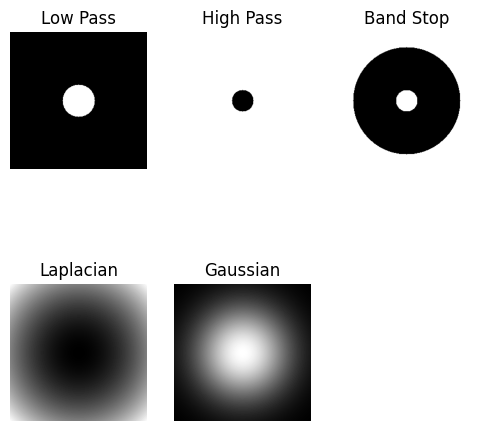

In [6]:
plt.figure(figsize = (6,6))
shape = (256,256)

plt.subplot(231)
plot_spectrum(np.abs(ideal_low_pass(shape, 30)), "Low Pass", log = False) 

plt.subplot(232)
plot_spectrum(np.abs(ideal_high_pass(shape, 20)), "High Pass", log = False) 

plt.subplot(233)
plot_spectrum(np.abs(ideal_band_stop(shape, 20, 100)), "Band Stop", log = False) 

plt.subplot(234)
plot_spectrum(np.abs(laplacian_high_pass(shape)), "Laplacian", log = False) 

plt.subplot(235)
plot_spectrum(np.abs(gaussian_low_pass(shape, 60, 60)), "Gaussian", log = False) 


## Visualisation of the results for each run. 
* Define the case number and the name of the chosen image, for example, the number 4 and the name apollo17 to refer to the execution of the `case4.in` file located at `/test_cases_in_out`

In [9]:
def get_img_result(case_number, case_name):
    img_in = iio.imread(f"test_cases_data/{case_name}.png")
    img_out = iio.imread(f"test_cases_my_results/case{case_number}.png")
    spec_out = iio.imread(f"test_cases_my_results_spec/case{case_number}.tif")
    img_ref = iio.imread(f"test_cases_reference/{case_name}_ref-case{case_number}.png")
    return img_in, img_out, spec_out, img_ref

def plot_img_result(case_number, case_name, title):
    
    img_in, img_out, spec_out, img_ref = get_img_result(case_number, case_name)
    plt.figure(figsize = (8,8))
    plt.title(title)
    plt.subplot(221)
    plt.imshow(img_in, cmap="gray"); plt.axis('off'); plt.title('Original Image')


    plt.subplot(222)
    plt.imshow(img_out, cmap="gray"); plt.axis('off'); plt.title('Filtered Image')


    plt.subplot(223)
    spec_in = np.fft.fftshift(np.fft.fft2(img_in, axes=(0,1))) 
    plot_spectrum(np.abs(spec_in), "Original Spectrum", log = True)

    plt.subplot(224)
    plot_spectrum(spec_out, "Filtered Spectrum", log = True)
    plt.plot()

/tmp/ipykernel_4426/4254355038.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize = (8,8))


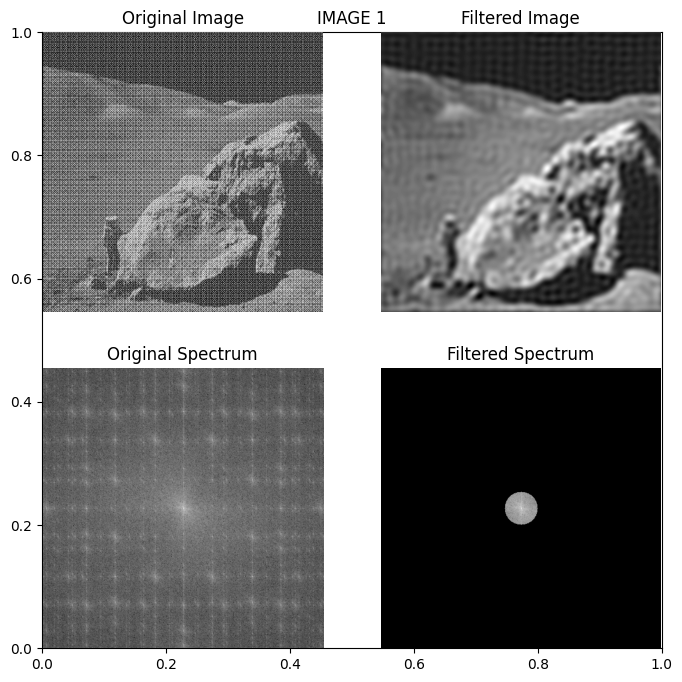

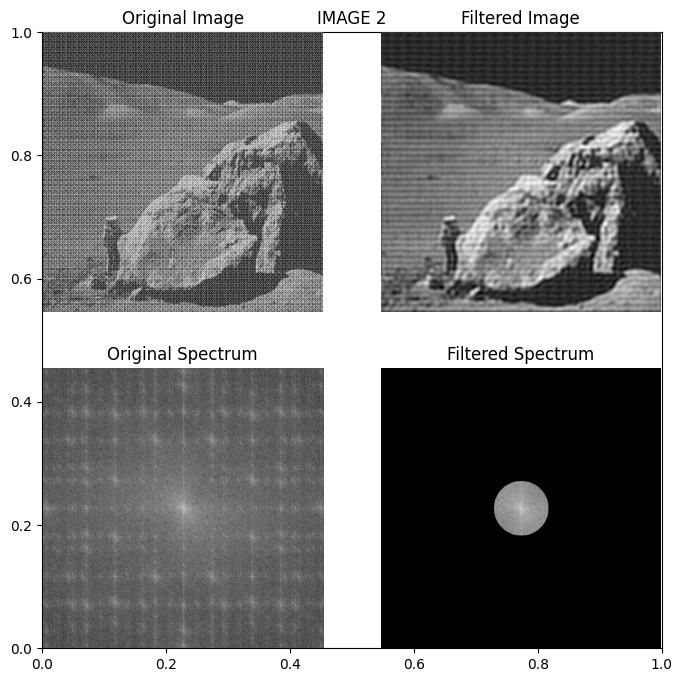

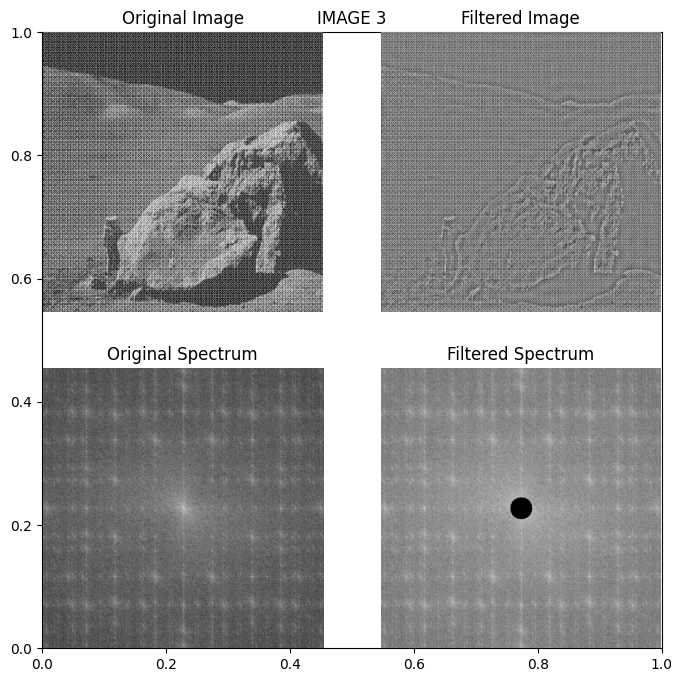

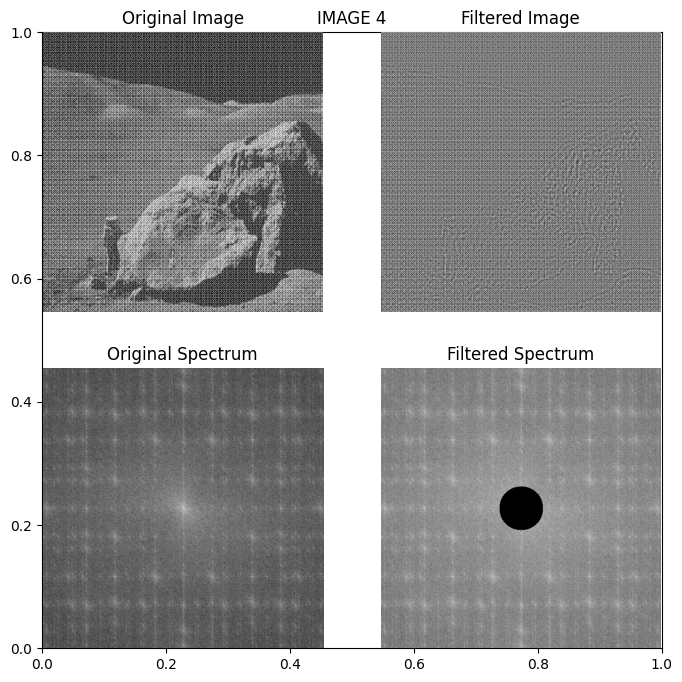

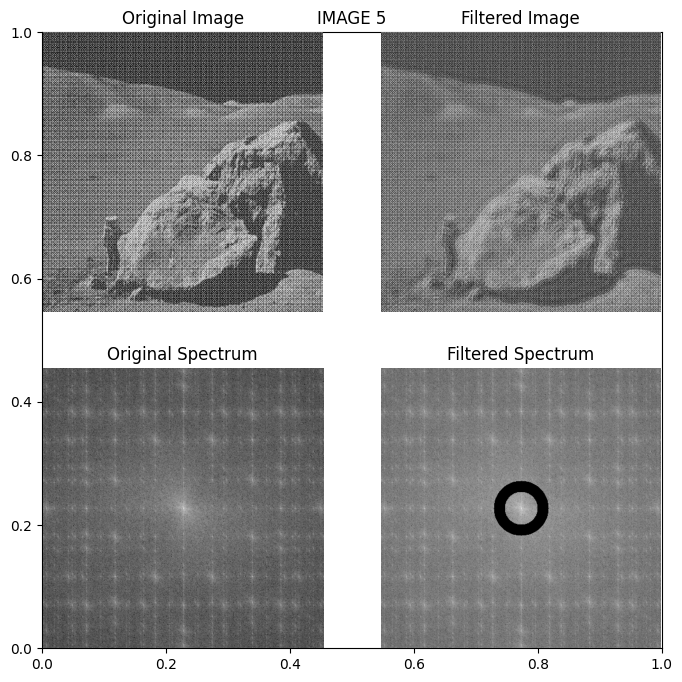

...

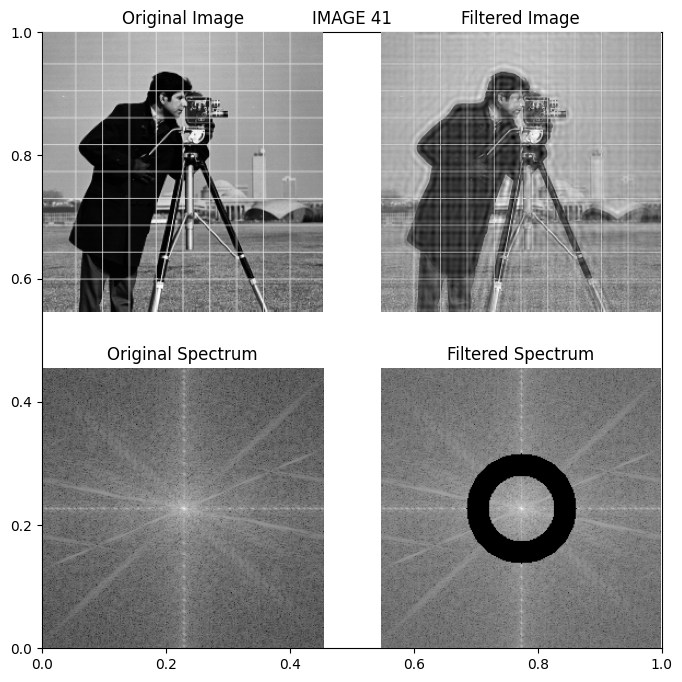

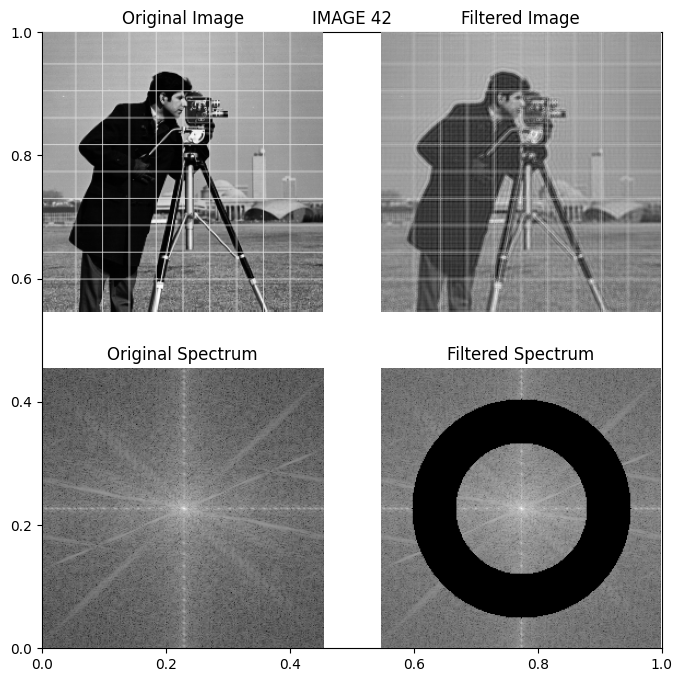

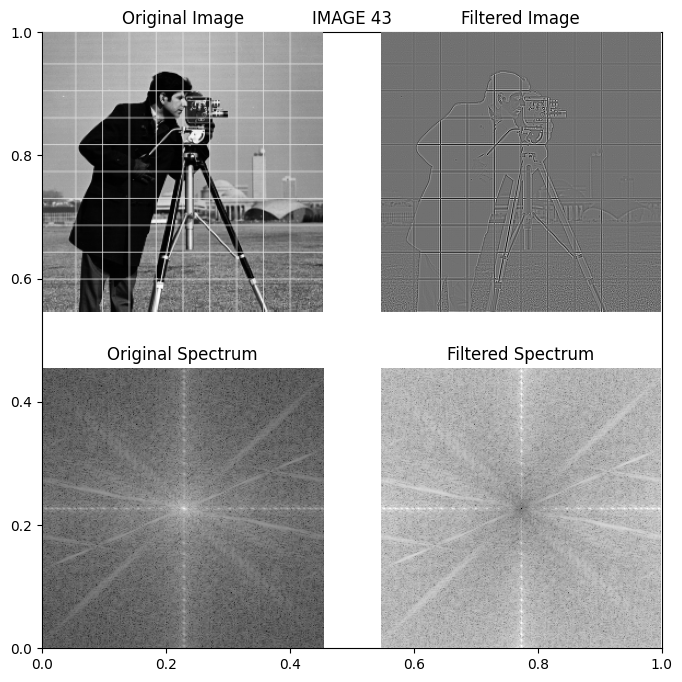

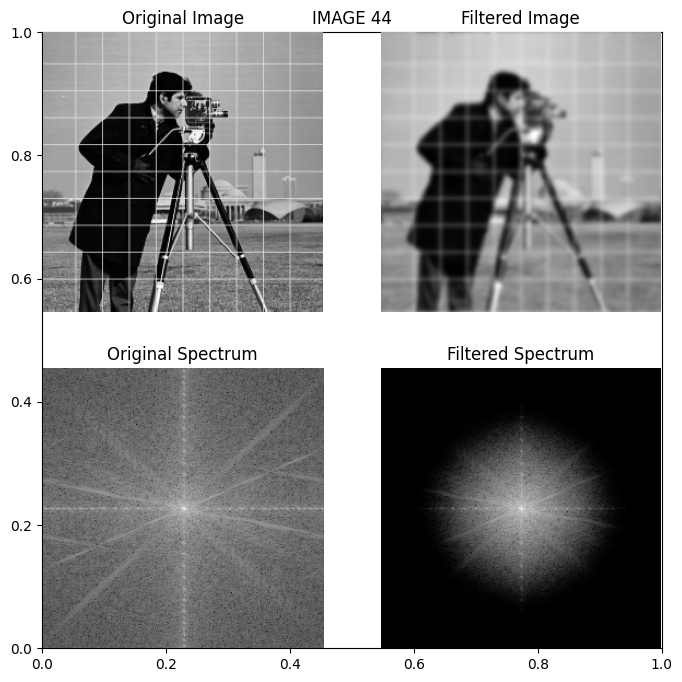

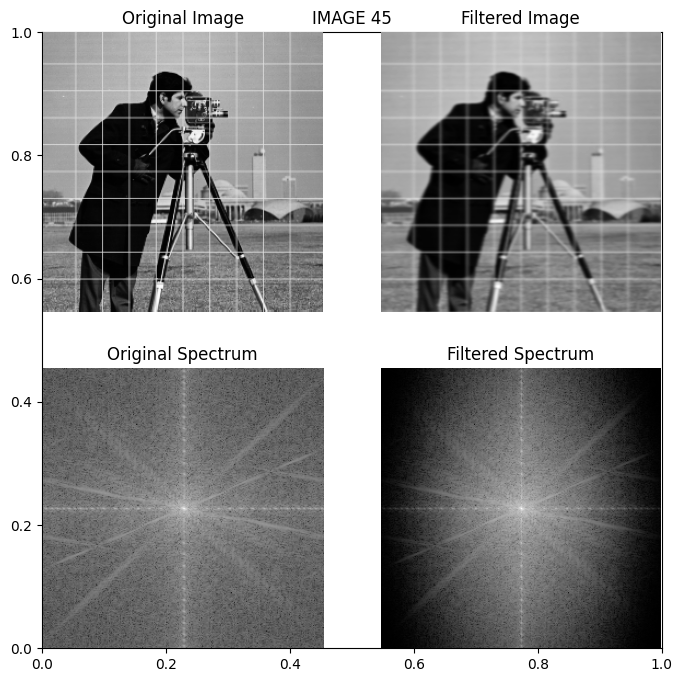

In [11]:
for i in range(1,46):
    case_number = i
    
    if case_number < 10:
        case_name = "apollo17"
    elif case_number < 19:
        case_name = "arara"
    elif case_number < 28:
        case_name = "arara_noise"
    elif case_number < 37:
        case_name = "baboon"
    else:
        case_name = "cameraman"
        
        
    plot_img_result(case_number, case_name, f"IMAGE {i}")